<a href="https://colab.research.google.com/github/rehabreda/Projects/blob/master/Deep_Dream/Deep_Dream_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
### import libraries
import tensorflow as tf 
import numpy as np 
import matplotlib.pyplot as plt 
from tensorflow.keras.preprocessing import image 
from IPython.display import clear_output
%matplotlib inline


In [2]:
!pip install tensorflow==2.0.0-rc1

     |████████████████████████████████| 86.3MB 1.2MB/s 
     |████████████████████████████████| 4.3MB 64.0MB/s 
     |████████████████████████████████| 501kB 55.5MB/s 
  Found existing installation: tensorflow 1.15.0
    Uninstalling tensorflow-1.15.0:
      Successfully uninstalled tensorflow-1.15.0


In [0]:
url='https://media.vogue.in/wp-content/uploads/2018/04/featured-Recovered1.jpg'

188416/180237 [===============================] - 1s 3us/step


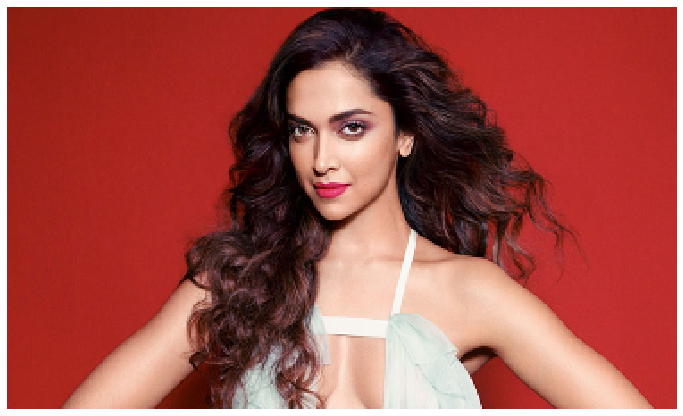

In [5]:
##download image 
def download(url,target_size=None):
  name=url.split('/')[-1]
  path=tf.keras.utils.get_file(name,url)
  img=tf.keras.preprocessing.image.load_img(path,target_size=target_size)
  return img

## normalize image 
def deprocess(img):
  img=255*(img +1.0)/2.0
  return tf.cast(img,tf.uint8)

## display image 
def show(img):
  plt.figure(figsize=(12,12))
  plt.axis('off')
  plt.imshow(img)
  plt.show


img=download(url,target_size=[225, 375])
img = np.array(img)
show(img) 




In [6]:
## download pre-trained model

from tensorflow.keras.applications import InceptionV3
base_model=InceptionV3(weights='imagenet',include_top=False)

87916544/87910968 [==============================] - 3s 0us/step


In [6]:
base_model.summary()

Model: "inception_v3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, None, None, 3 864         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, None, None, 3 96          conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, None, None, 3 0           batch_normalization[0][0]        
_______________________________________________________________________________________

In [0]:
### maximized acttivation of chosen layers
layers=['mixed3', 'mixed5'] ## chosen layer 
layers_outputs=[base_model.get_layer(layer).output for layer in layers]


### activation model 
dream_model=tf.keras.models.Model(inputs=base_model.input,outputs=layers_outputs)



In [0]:
## calculate loss (sum of activations in chosen layers)
def calc_loss(img,model):
  img_batch=tf.expand_dims(img,axis=0) ## batch_size=1
  activations=model(img_batch)
  losses=[]
  for act in activations:
    loss=tf.math.reduce_mean(act)
    losses.append(loss)
  return tf.reduce_sum(losses)


In [0]:
### calculate gradients of loss to respect of image (input)
@tf.function
def deep_dream(model,img,step_size):
  with tf.GradientTape() as tape:
    tape.watch(img)
    loss=calc_loss(img,model)
  grads=tape.gradient(loss,img)
  ##normalize gradients 
  grads/=tf.math.reduce_std(grads) + 1e-8 

  ## add grads to img
  img= img + grads*step_size
  img = tf.clip_by_value(img, -1, 1)

  return loss ,img
  

In [0]:
def run_deep_dream(model,img,steps=100,step_size=.01):
  img=tf.keras.applications.inception_v3.preprocess_input(img)
  for step  in range(steps):
    loss,img=deep_dream(model,img,step_size)
    if step%100==0:
      clear_output(wait=True)
      show(deprocess(img))
      print ("Step {}, loss {}".format(step, loss))

  result=deprocess(img)
  clear_output(wait=True)
  show(img)  
  return result




/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


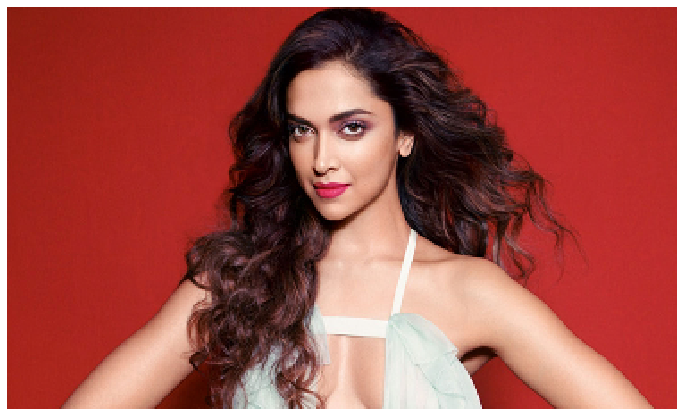

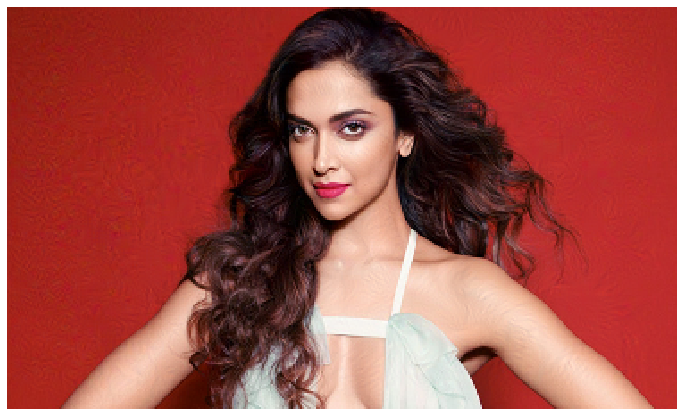

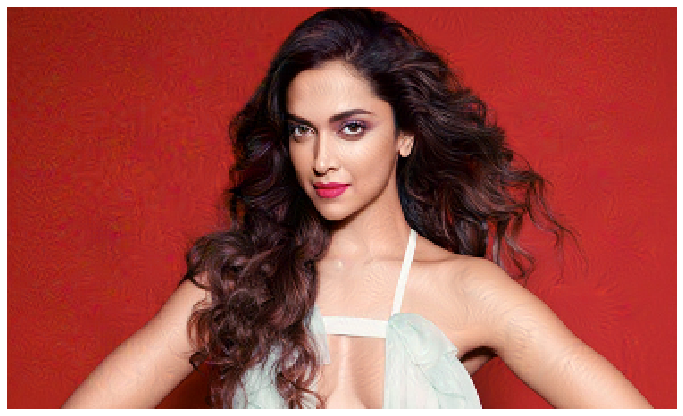

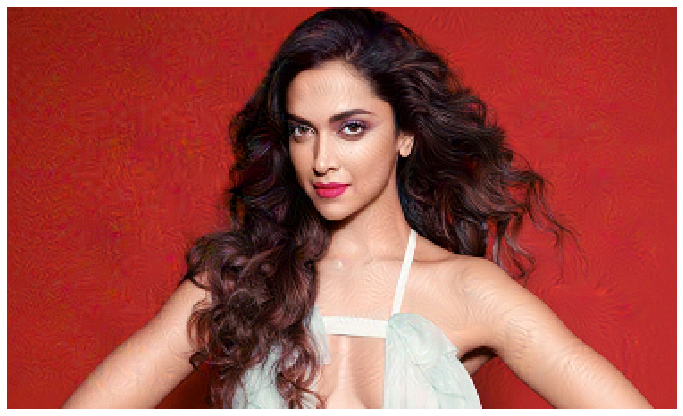

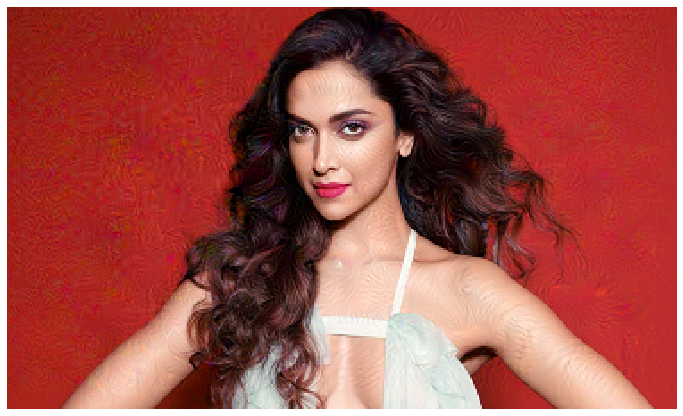

...

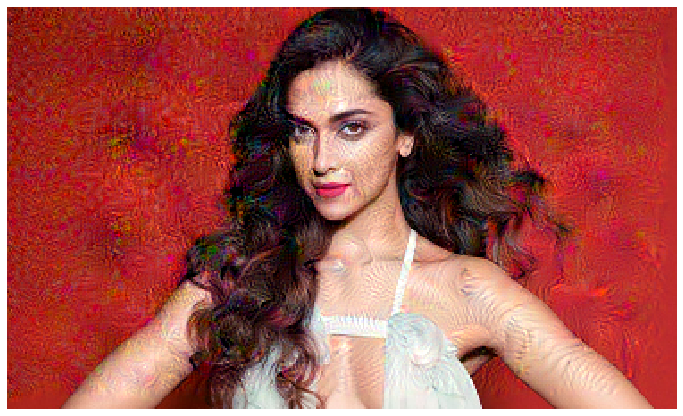

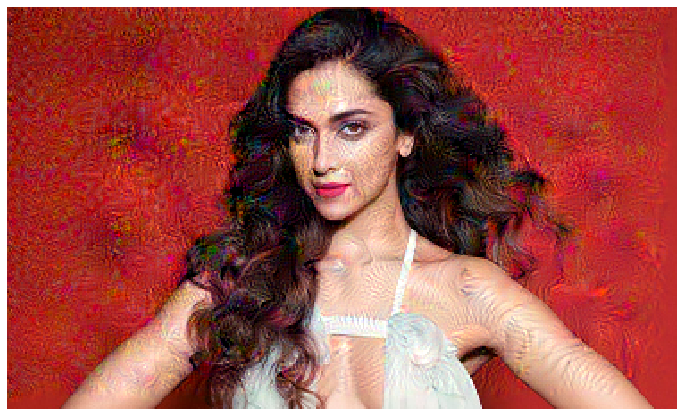

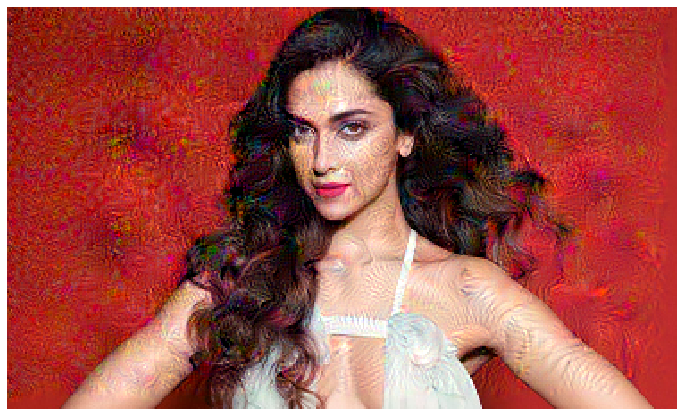

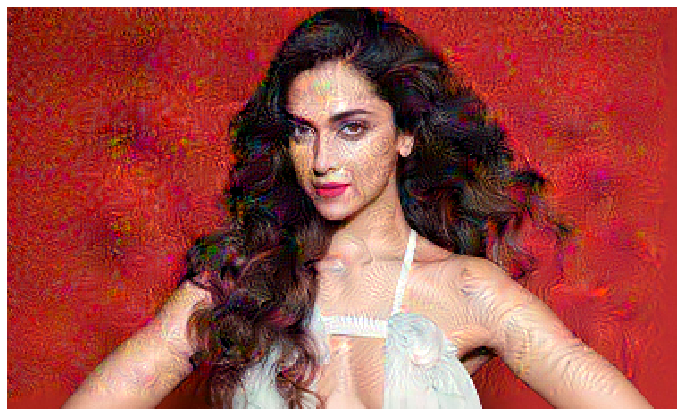

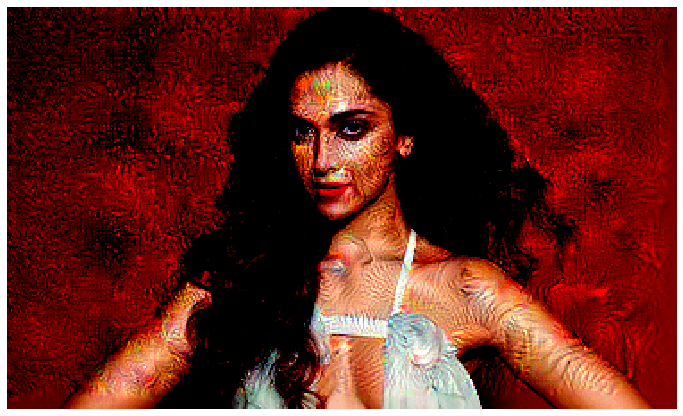

In [29]:
deep_dream_image=run_deep_dream(dream_model,img,steps=2000, step_size=0.001)

In [2]:
tf.__version__

'2.0.0-rc1'

In [0]:
### chosse another layer
layers=['mixed5', 'mixed6','mixed7','mixed8'] ## chosen layer 
layers_outputs=[base_model.get_layer(layer).output for layer in layers]


### activation model 
dream_model=tf.keras.models.Model(inputs=base_model.input,outputs=layers_outputs)




/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


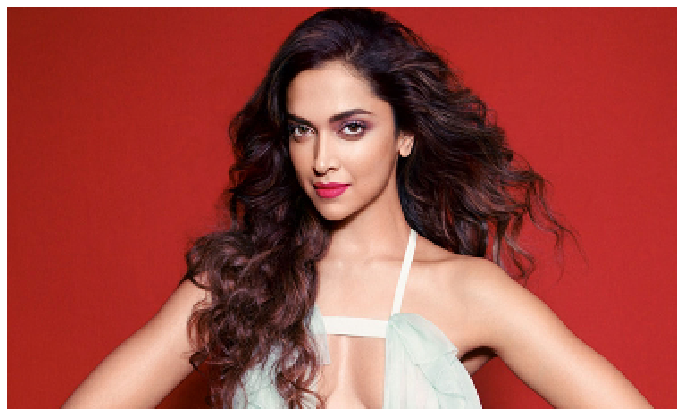

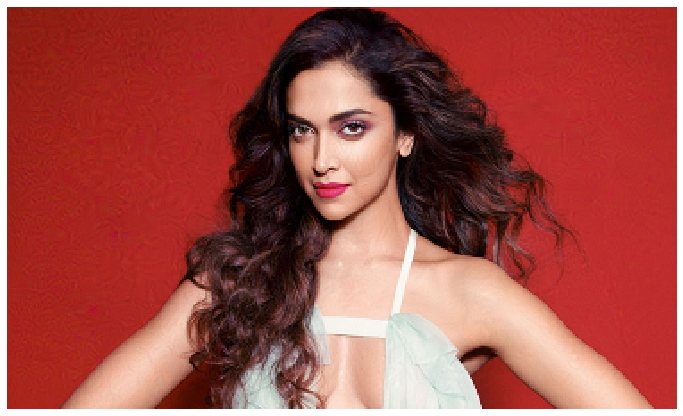

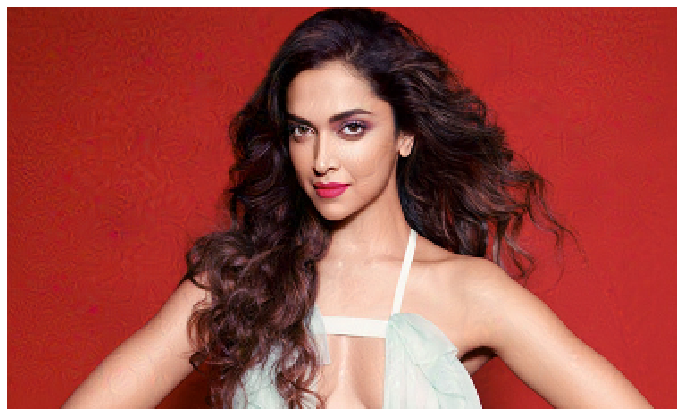

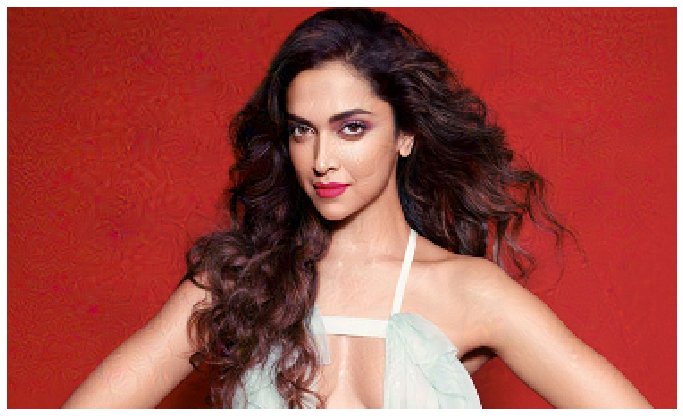

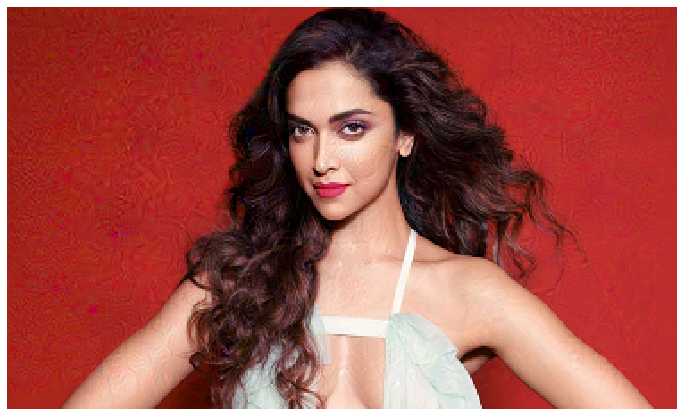

...

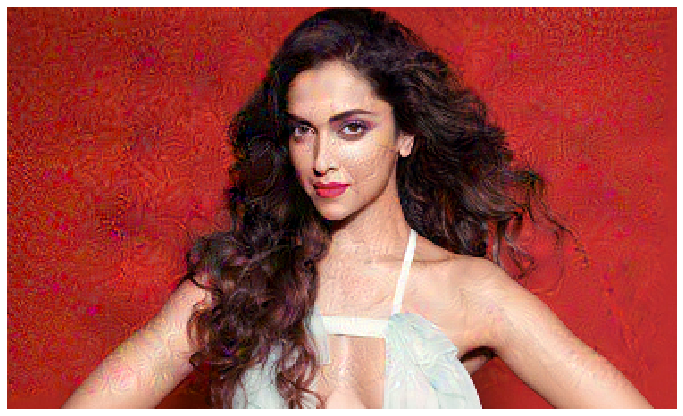

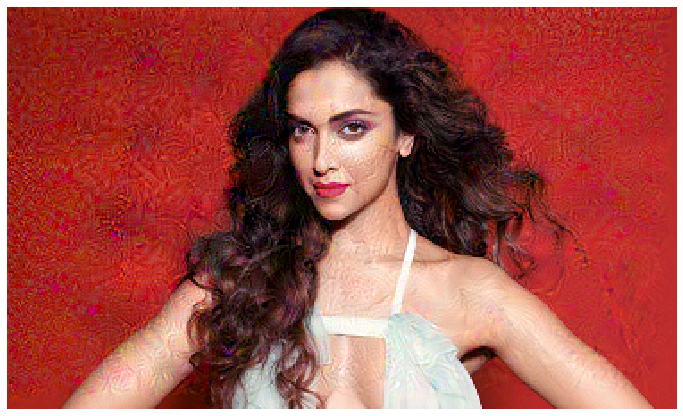

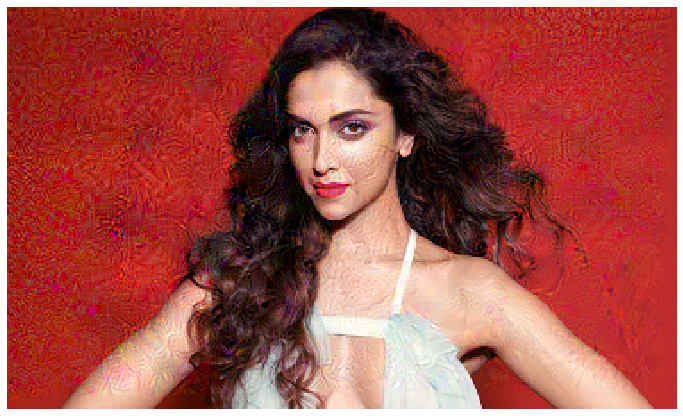

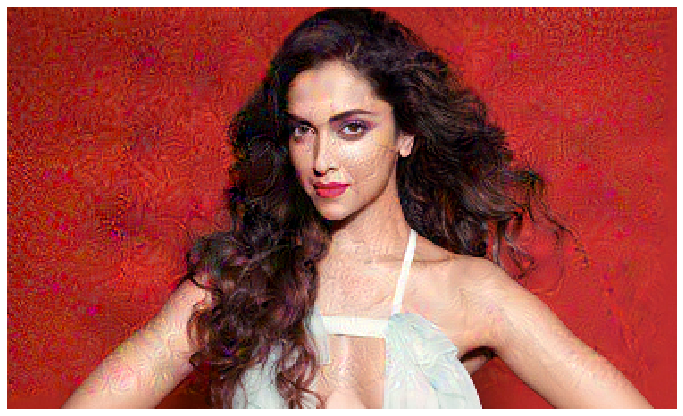

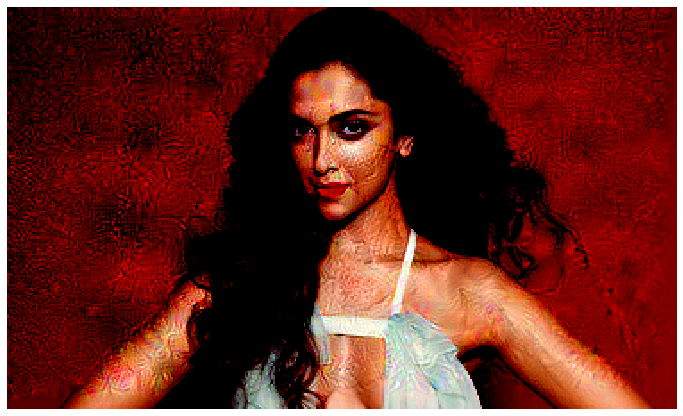

In [12]:
deep_dream_image=run_deep_dream(dream_model,img,steps=2000, step_size=0.001)

In [14]:
## try VGG16 model 
import keras 
from tensorflow.keras.applications import VGG16
vgg16=VGG16(include_top=False,weights='imagenet')


58892288/58889256 [==============================] - 2s 0us/step


In [15]:
vgg16.summary()

Model: "vgg16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, None, None, 3)]   0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, None, None, 64)    1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, None, None, 64)    36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, None, None, 64)    0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, None, None, 128)   73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, None, None, 128)   147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, None, None, 128)   0     

In [0]:
### chosse another layer
layers=['block5_conv1', 'block5_conv2','block5_conv3','block5_pool'] ## chosen layer 
layers_outputs=[vgg16.get_layer(layer).output for layer in layers]


### activation model 
dream_model=tf.keras.models.Model(inputs=vgg16.input,outputs=layers_outputs)



/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


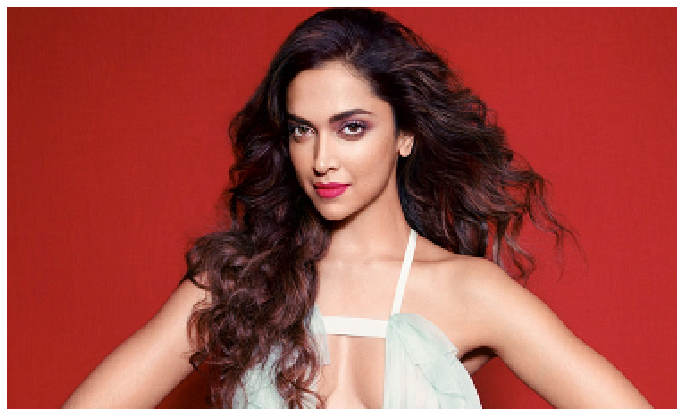

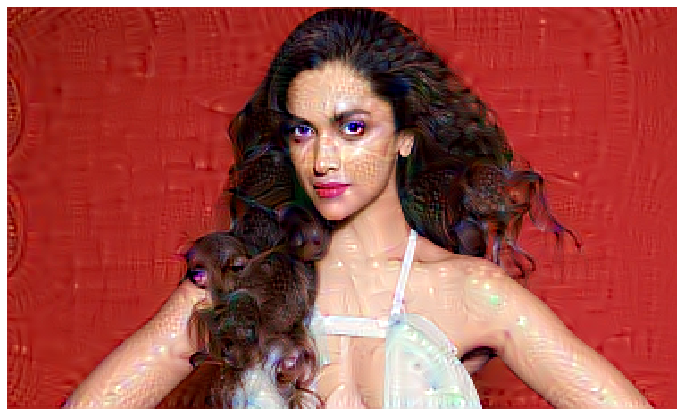

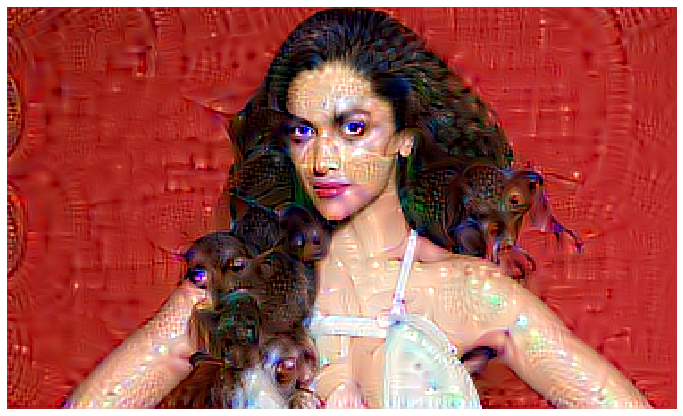

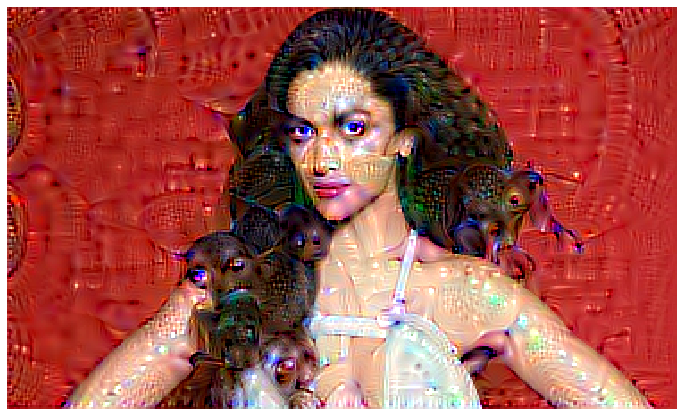

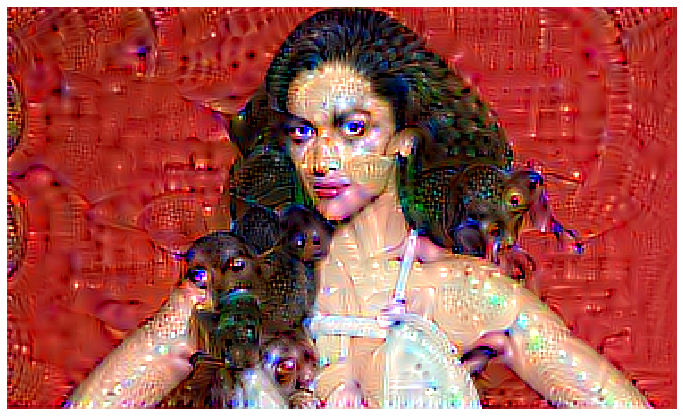

...

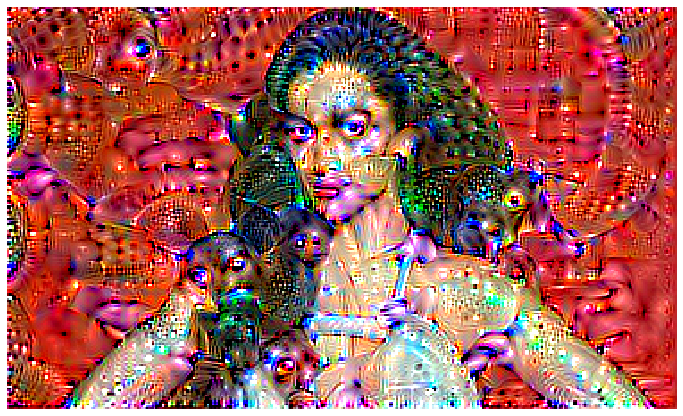

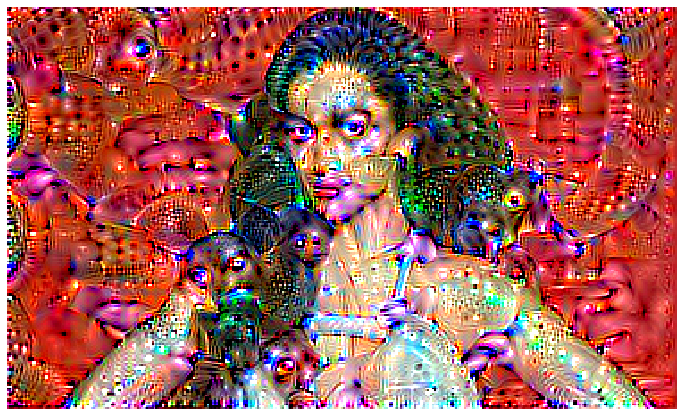

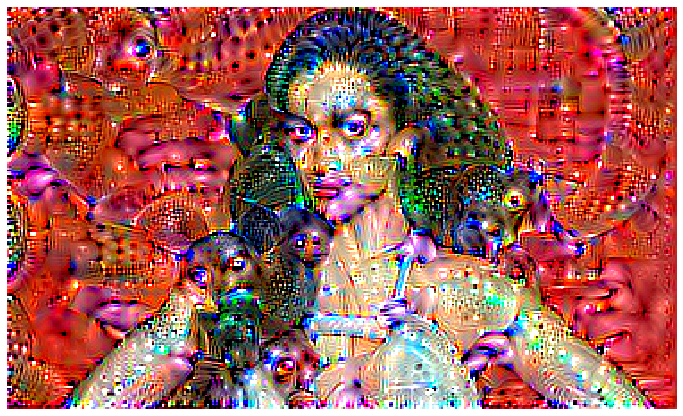

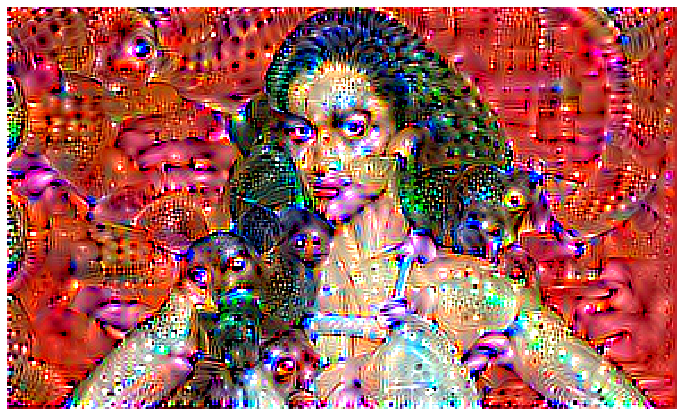

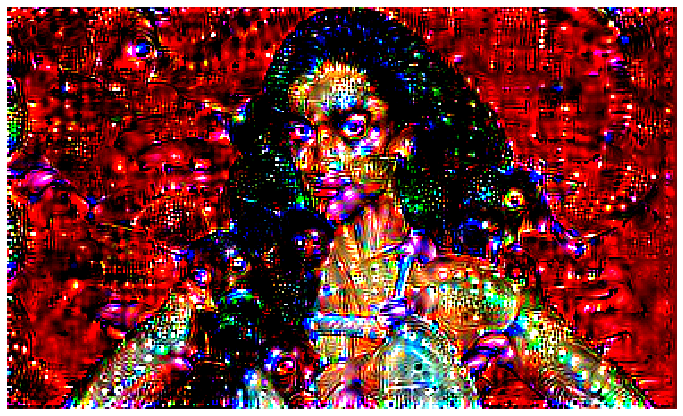

In [18]:
deep_dream_image=run_deep_dream(dream_model,img,steps=2000, step_size=0.001)